# Prérequis

Ce notebook requiert les modules matplotlib, seaborn, plotly, ainsi que le module imgtools qui regroupe des fonctions nous avons crées pour ce projet.  
Le notebook utilise également le module 'tqdm' (https://github.com/tqdm/tqdm#readme). Si vous ne souhaitez pas le télécharger, laisser la valeur False ci-dessous, sinon la passer à True.

In [1]:
with_tqdm = True

# Initialisation

## Imports

In [2]:
# Modules usuels
import pandas as pd
import numpy as np
import random
import pickle
import math as m
import string
import warnings
from collections import defaultdict

# Modules graphiques
import matplotlib.pyplot as plt
import plotly as py
import plotly.figure_factory as ff
from plotly.offline import iplot
import plotly.graph_objects as go
import seaborn as sns
import cufflinks as cf

# Modules de traitement du texte
import re
import nltk
from nltk.stem.porter import PorterStemmer
from nltk.stem import WordNetLemmatizer

# Modules additionnels
import imgtools as imt
if imt.version != 2:
    raise ImportError("Votre version de imgtools n'est pas la bonne !")
if with_tqdm:
    from tqdm import tqdm
else:
    def tqdm(it):
        return it

## Téléchargements

In [3]:
# NTLK corpuses
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\basti\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

## Options

In [4]:
# Exceptions
warnings.simplefilter(action='ignore', category=FutureWarning) # pour sns.distplot

# Graphics
sns.set_style()
py.offline.init_notebook_mode(connected=False)
cf.go_offline(connected=False)

## Constantes

In [5]:
# NTLK corpuses
STOPWORDS = set(nltk.corpus.stopwords.words('french'))

# Relative paths
PATH_DATAFRAME = "./trainset.csv"
PATH_TRAIN = "../images/image_train"
PATH_TEST = "../images/image_test"

# Extraction des données

In [6]:
# Chargement du jeu de données d'entrainement
df = pd.read_csv(PATH_DATAFRAME).set_index('productid')
display(df.head())

,designation,description,imageid,target
productid,,,,
3804725264,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,1263597046,0
436067568,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,1008141237,1
201115110,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,938777978,2
50418756,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,457047496,3
278535884,La Guerre Des Tuques,Luc a des id&eacute;es de grandeur. Il veut or...,1077757786,4


In [20]:
# Chargement de la table de correspondance des labels
lab_enc = pd.read_csv('labels_encoding.csv')
display(lab_enc)

,prdtypecode,target,prdtype
0,10,0,livres_adulte
1,2280,1,magazines
2,50,2,accessoires_jeux_videos
3,1280,3,jouets_enfance
4,2705,4,livres_et_illustres
5,2522,5,papeterie
6,2582,6,mobilier_jardin_cuisine
7,1560,7,mobilier_interieur_litterie
8,1281,8,jeux_societe
9,1920,9,accessoires_interieur


# Distribution des classes

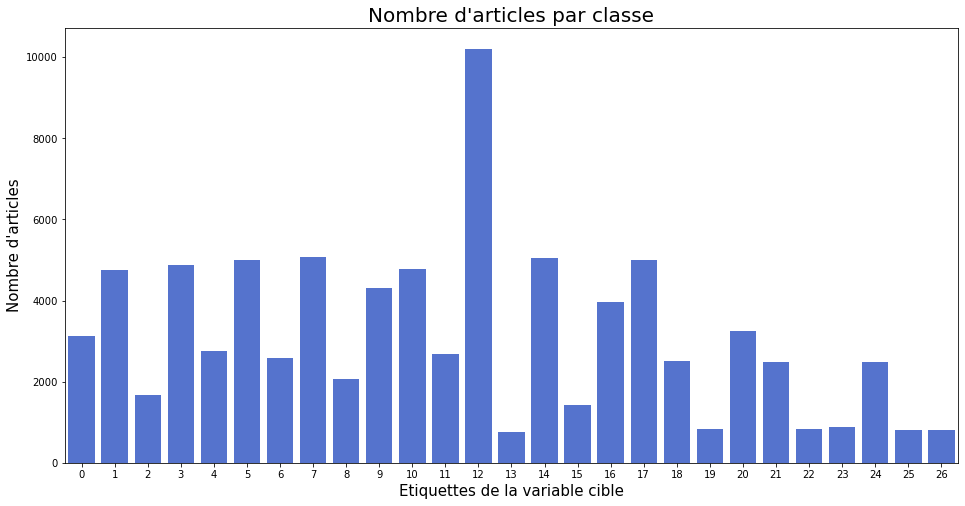

In [8]:
# Affichage de la distribution des classes
fig, ax = plt.subplots(figsize=(16,8))
sns.countplot(ax=ax, data=df, x='target', color='royalblue')
plt.title("Nombre d'articles par classe", fontsize=20)
plt.xlabel("Etiquettes de la variable cible", fontsize=15)
plt.ylabel("Nombre d'articles", fontsize=15)
plt.show();

Ce graphique illustre le déséquilibre entre les classes. Le rapport entre la classe majoritaire et les classes minoritaires est de 12 environ.

# Valeurs manquantes

## Vue globale

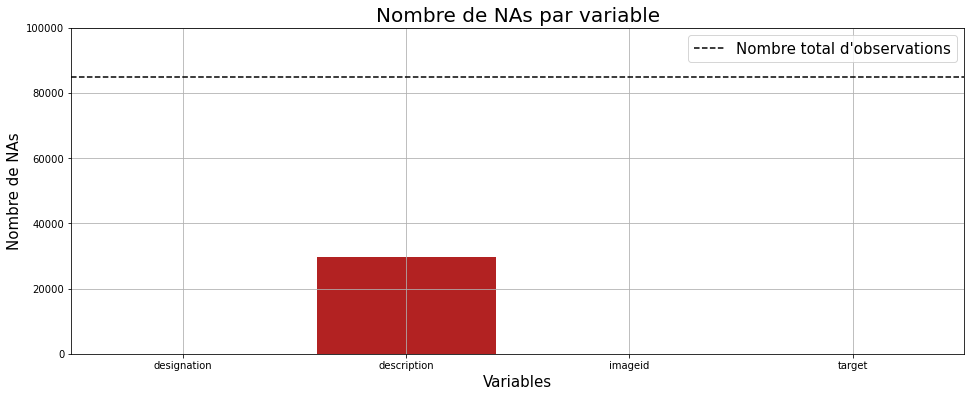

In [9]:
# Nombre de NAs par colonne
plt.figure(figsize=(16, 6))
plt.bar(x=df.columns, height=df.isna().sum(), color='firebrick')
plt.hlines(len(df), -0.5, 3.5, color='k', linestyle='dashed', label="Nombre total d'observations")
plt.axis([-0.5, 3.5, 0, 100000])
plt.title("Nombre de NAs par variable", fontsize=20)
plt.xlabel("Variables", fontsize=15)
plt.ylabel("Nombre de NAs", fontsize=15)
plt.legend(fontsize=15)
plt.grid('on')
plt.show();

Tous les articles mis en vente ont un champ 'designation' complété et une image associée, référencée par 'imageid'. Il doit s'agir de données obligatoires pour que l'article soit mis en vente.  
En revanche le champ 'description' doit être optionel, car il est vide pour environ 35% des articles.  
Enfin, on constate que toutes nos données sont bien étiquettées.

## Répartition des valeurs manquantes selon les classes

In [10]:
# Calcul des distributions de classes et des NAs
count_na = lambda x: x.isnull().sum()
func_gby = {'description': count_na, "imageid": 'count'}
cls_descr = df[['target', 'imageid', 'description']].groupby("target").agg(func_gby).reset_index()
cls_descr = cls_descr.rename({"description":"nb_nan_per_class", "imageid":"count_prod_per_class"}, axis=1)
cls_descr['%_nan'] = round((cls_descr["nb_nan_per_class"]/cls_descr['count_prod_per_class'])*100)
cls_descr['%Class'] = round((cls_descr["count_prod_per_class"]/len(df))*100)
cls_descr = cls_descr.set_index('target')

In [11]:
# Affichage
fig = go.Figure(data=[
    go.Bar(name='Articles', x=cls_descr.index, y=cls_descr["count_prod_per_class"]),
    go.Bar(name='NAs', x=cls_descr.index, y=cls_descr["nb_nan_per_class"])
])
# Change the bar mode
fig.update_layout(barmode='group', title_text="Valeurs manquantes par classe",
                  xaxis_title="Classes", yaxis_title="Nombre")
fig.show();

Il est clair que certaines classes de produits sont plus touchées que d'autres par les descriptions manquantes, notamment les classes 0, 1, 10, 16 (que nous avons respectivement intitulées 'livres_adultes, 'magazines', 'livres_jeunesse', 'cartes_a_jouer'). Ces types de produits sont certainement davantage vendus par des amateurs qui ne sont pas en mesure de fournir une description rigoureuse. De plus, le niveau de complexité et le prix relativement faibles de ces produits font peut-être qu'un acheteur se contenterait d'assez peu de détails.  
De manière générale, on peut supposer que pour des produits de faible complexité, l'essentiel des informations peut être condensé dans le champ 'designation', rendant le champ 'description' peu utile.

# Analyse du texte 

## Extraction des informations

In [12]:
# Functions for statistical analysis

def get_word_count(x):
    cd=pd.isnull(x)
    if cd==True:
        return np.nan
    else :
        return len(str(x).split()) 
    
def get_unique_words(x):
    if pd.isnull(x):
        return np.nan
    else :
        return len(set(str(x).split()))

def get_stop_words_count(x):
    if pd.isnull(x):
        return np.nan
    else :
        return len([w for w in str(x).lower().split() if w in STOPWORDS])

def get_chart_count(x):
    if pd.isnull(x):
        return np.nan
    else :
        return len(str(x))

def get_mean_word_length(x):
    if pd.isnull(x):
        return np.nan
    else :
        return len(set(str(x).split()))

def get_punctuation_count(x):
    if pd.isnull(x):
        return np.nan
    else :
        return len([c for c in str(x) if c in string.punctuation])

In [13]:
# Extract text statistics
text_stats = pd.DataFrame(index=df.index)
text_stats['design_words_count'] = df['designation'].apply(get_word_count)
text_stats['design_unique_words_count'] = df['designation'].apply(get_unique_words)
text_stats['design_mean_word_length'] = df['designation'].apply(get_mean_word_length)
text_stats['design_stopwords_count'] = df['designation'].apply(get_stop_words_count)
text_stats['design_punctuation_count'] = df['designation'].apply(get_punctuation_count)
text_stats['design_chars_count'] = df['designation'].apply(get_chart_count)
text_stats['descr_words_count'] = df['description'].apply(get_word_count)
text_stats['descr_unique_words_count'] = df['description'].apply(get_unique_words)
text_stats['descr_mean_word_length'] = df['description'].apply(get_mean_word_length)
text_stats['descr_stopwords_count'] = df['description'].apply(get_stop_words_count)
text_stats['descr_punctuation_count'] = df['description'].apply(get_punctuation_count)
text_stats['descr_chars_count'] = df['description'].apply(get_chart_count)
display(text_stats.head())

,design_words_count,design_unique_words_count,design_mean_word_length,design_stopwords_count,design_punctuation_count,design_chars_count,descr_words_count,descr_unique_words_count,descr_mean_word_length,descr_stopwords_count,descr_punctuation_count,descr_chars_count
productid,,,,,,,,,,,,
3804725264,14,11,11,0,6,88,NaN,NaN,NaN,NaN,NaN,NaN
436067568,39,34,34,9,12,206,NaN,NaN,NaN,NaN,NaN,NaN
201115110,12,12,12,0,1,76,109.0,88.0,88.0,31.0,51.0,760.0
50418756,10,9,9,1,4,63,NaN,NaN,NaN,NaN,NaN,NaN
278535884,4,4,4,2,0,20,34.0,30.0,30.0,14.0,15.0,213.0


## Représentation des statistiques

### Analyse des champs 'designation' et 'description' (pris séparément)

In [14]:
cols = ['design_words_count', 'design_unique_words_count', 'design_mean_word_length', 'design_stopwords_count']
text_stats[cols].iplot(kind='box', title= "Statistiques de la variable 'designation'")

Dans le champ 'designation', la médiane se situe à 10 mots. La dispersion est en général assez faible, mais certaines descriptions vont jusqu'à 50 mots.  
Si l'on regarde le nombre de mots uniques, on observe sensiblement la même chose, ce qui laisse supposer qu'il y a peu de cas de répétition.  
La longueur moyenne des mots est typiquement d'environ 10 caractères, mais certains vont jusqu'à plus de 40 caractères. Ces longs "mots" pourraient être en fait des références produit.  
Le nombre de stopwords (mots considérés d'emblée comme non informatifs) approche 0, mais dans certains cas on peut en trouver jusqu'à 20 environ. C'est assez étrange, mais on peut sans doute attribuer cela à l'aléa humain introduit par les utilisateurs.

In [15]:
cols = ['descr_words_count', 'descr_unique_words_count', 'descr_mean_word_length', 'descr_stopwords_count']
text_stats[cols].iplot(kind='box', title="Statistiques de la variable 'description'")

Dans le champ 'description', on a typiquement (intervalle interquartile) entre 40 et 160 mots. Cependant le maximum est d'environ 2000 mots.  
La longueur médiane des mots est typiquement (intervalle interquartile) entre 30 et 110 caractères, et cela peut aller jusqu'à plus de 700 caractères. On peut supposer que ces très longs "mots" sont en fait des références produit ou encore des URL de sites web.  

**Pour tous les résultats observés jusqu'ici, on constate que l'écart interquartile est relativement faible, mais que l'étendue du troisième quartile est beaucoup plus grande, ce qui indique la présence d'outliers.**

### Comparaison des champs 'designation' et 'description'

In [52]:
chars_counts = text_stats[['design_chars_count', 'design_punctuation_count', 'descr_chars_count', 'descr_punctuation_count']]
chars_counts.iplot(kind='box', title="Distributions du nombre de caractères dans 'designation' et 'description'")

Le champ 'designation' contient typiquement (intervalle interquartile) entre 40 à 90 caractères, et le maximum est de 250 caractères. Ce nombre de 250 n'est sans doute pas une coïncidence, mais une limite imposée aux utilisateur, ce champ étant destiné à être concis. La présence de ponctuation dans ce champ est assez étrange, mais reste exceptionnelle.  
Le champ 'description contient typiquement (intervalle interquartile) entre 300 et 1000 caractères, et le maximum est de plus de 12 000 caractères ! Il doit y avoir une limite de caractères mais elle est manifestement très grande. La ponctuation semble cohérente.


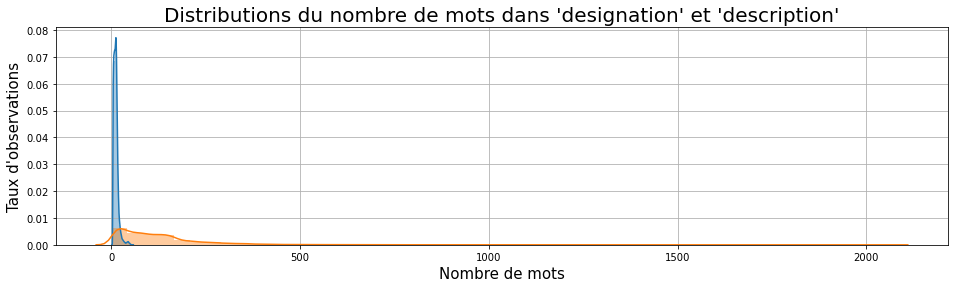

In [18]:
plt.figure(figsize=(16, 4))
sns.distplot(text_stats['design_words_count'], label='design_words_count')
sns.distplot(text_stats['descr_words_count'], label='descr_words_count')
plt.title("Distributions du nombre de mots dans 'designation' et 'description'", fontsize=20)
plt.xlabel("Nombre de mots", fontsize=15)
plt.ylabel("Taux d'observations", fontsize=15)
plt.grid('on')
plt.show();

Ce graphique permet de confirmer les observations précédentes.   
Le champ 'description' a une moyenne et surtout une dispersion considérablement supérieure à celles du champ 'designation'.  
De plus, les extrêmes observés pour le champ 'description' sont manifestement des outliers.

In [19]:
def cleaning_data(x):
    
    if pd.isnull(x):
        return x
    else:
        sentences = nltk.sent_tokenize(x)
        lemmatizer = WordNetLemmatizer()

        # Lemmatization
        for i in range(len(sentences)):
            words = nltk.word_tokenize(sentences[i])
            words = [lemmatizer.lemmatize(word) for word in words if word not in STOPWORDS]
            sentences[i] = ' '.join(words) 
        sentences = ' '.join(sentences)
        
        # On retire les balises html
        sentences = re.sub('<[^<]+?>', '', sentences)
       
        return sentences

In [ ]:
# RESTE DU CODE

# Analyse des images

## Affichage de 5 images par classe

100%|██████████| 27/27 [00:09<00:00,  2.92it/s]


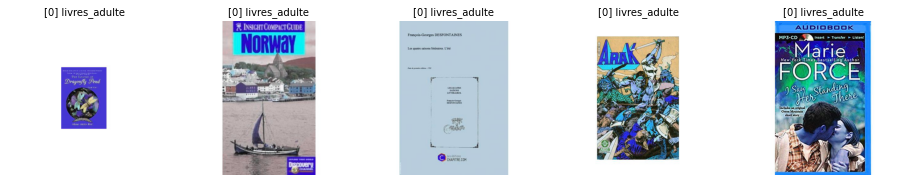

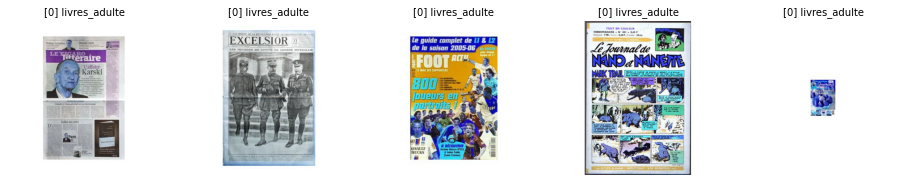

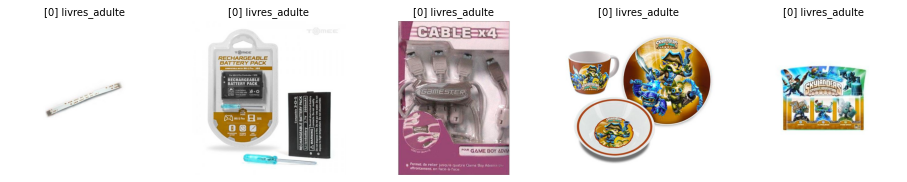

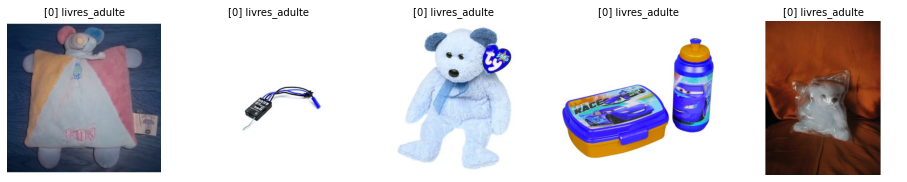

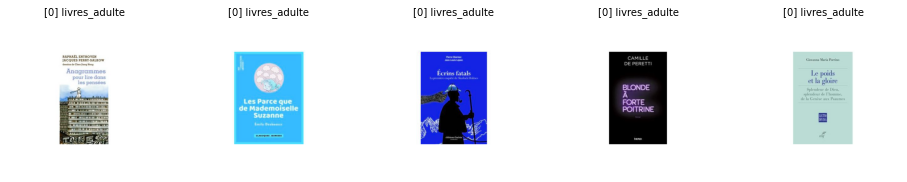

...

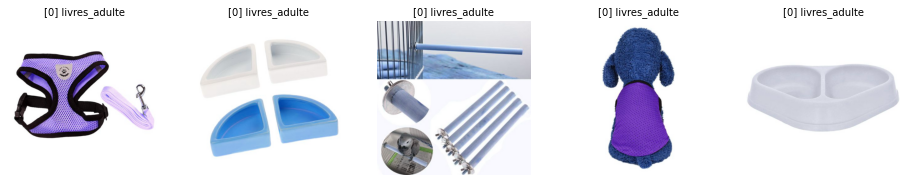

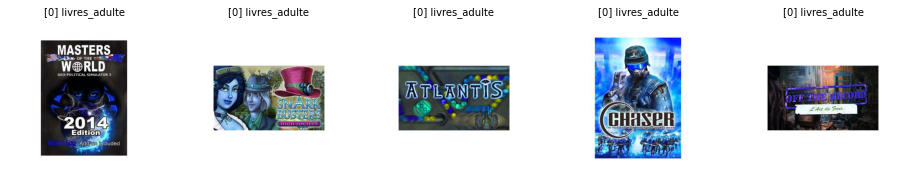

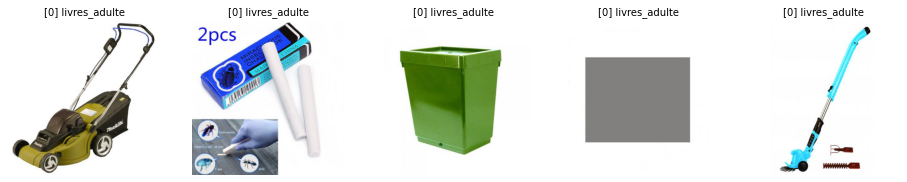

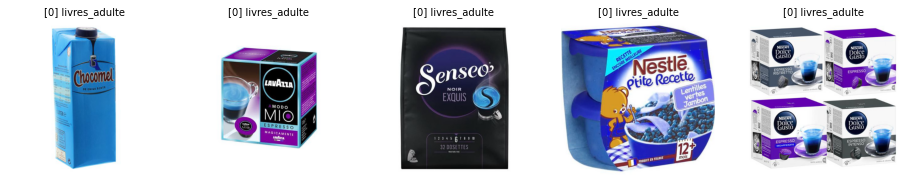

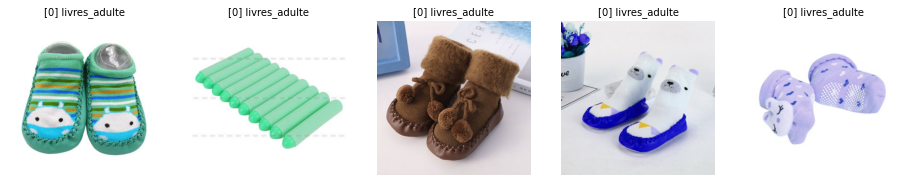

In [51]:
with plt.rc_context({'figure.max_open_warning': 0}):

    # Iterate through product codes
    for label in tqdm(lab_enc['target']):

        # Indexes matching label
        idxs = list(df[df['target'] == label].index)

        # Sample random specimens
        idxs_rand = random.sample(idxs, 5)
        
        # Extract imageids
        imageids = df.loc[idxs_rand, 'imageid']

        # Titres
        idx_lab = (lab_enc['target'] == label).index[0]
        titles = "[{}] ".format(lab_enc.at[idx_lab, 'target'])
        titles += lab_enc.at[idx_lab, 'prdtype']
        titles = [titles]*5

        # Load and display images
        images = imt.load_id(PATH_TRAIN, imageids)
        imt.disp_grid(images, 1, 5, titles=titles)

On constate déjà que même au sein d'une même classe, les images représentent des objets très divers.

## Images moyennes par classe

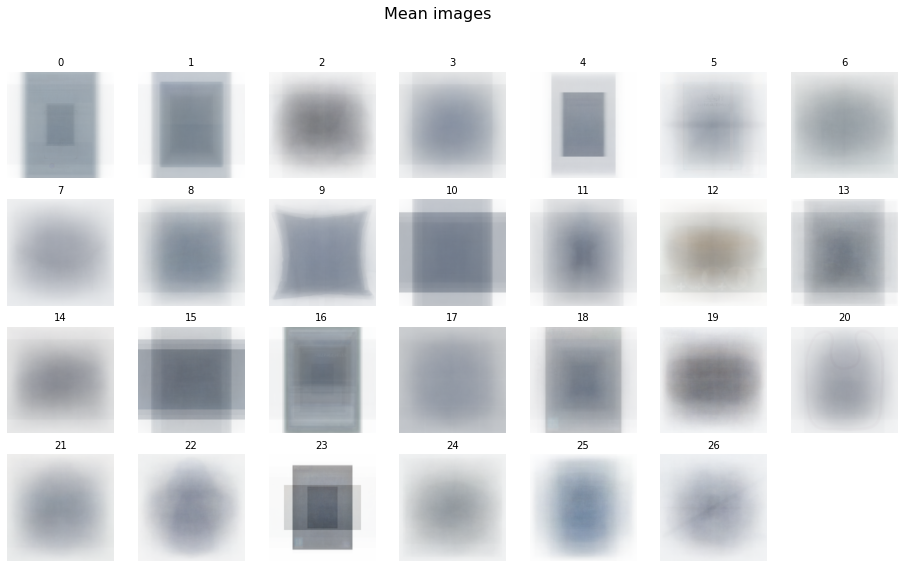

In [29]:
compute_mean_images = False # EDIT to run (or not) /!\ REALLY LONG computation /!\
save_result = False # EDIT to run (or not) /!\ Overwrites previous savefile if it exists /!\


SAVEFILE_NAME = 'mean_images_by_class.pkl'


if compute_mean_images:
    
    # Create empty container
    mean_images = dict()
    
    # Iterate through product codes
    for label in tqdm(lab_enc['target']):

        # Imageids matching label
        idxs = list(df[df['target'] == label].index)
        imageids = df.loc[idxs, 'imageid']
        
        # Load images
        images = imt.load_id(PATH_TRAIN, imageids)
        
        # Compute mean
        mean_images[label] = imt.mean_img(images)

        
if save_result:
    
    # Serialize in binary file
    with open(SAVEFILE_NAME, 'wb') as savefile:
        pickle.dump(mean_images, savefile)
    print("Results saved in '{}'.".format(SAVEFILE))



# Load and display
with open('mean_images_by_class.pkl', 'rb') as savefile:
    mean_images = pickle.load(savefile)
titles = list(lab_enc['target'].astype('str'))
imt.disp_grid(list(mean_images.values()), 4, 7, titles=titles, suptitle="Mean images")

Pour plusieurs classes, la dispersion de la luminance (les nuances de gris) est telle qu'on observe un genre de bruit gaussien 2D centré (classes 6, 7, 21, 24, ...). Pour quelques classes cependant, on observe des formes plus géométriques, surtout rectangulaires (classes 0, 1, 4, 10, 13, 15, 16, 23, ...). On pourrait imaginer que les objets concernés soit plutôt rectangulaires, et placés soit en portrait soit en paysage sur les images. Cependant, il faut être prudent, car toutes images ont été préformattées en RGB 500x500 pixels, et cela a pu créer un effet de cadre/bandeau sur les images.

Les couleurs observées, à dominante gris-brun, indiquent que la répartition entre les trois couleurs RGB est sensiblement la même (sauf par exemple pour la classe 25 un peu plus de bleu, ou la classe 19 un peu plus de rouge). La couleur observée au sein de chaque image semble relativement homogène, ce qui peut indiquer une forte dispersion pour chaque couleur primaire RGB (ce qui fait que le mélange des trois couleurs est à peu près le même partout).

Une telle dispersion nous oriente plutôt vers des méthodes de deep-learning.

In [53]:
# RESTE DU CODE